In [31]:
import os
import importlib
import glob
import collections

import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib as mpl
import matplotlib.pyplot as plt

import utils
# importlib.reload(utils)

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=160, facecolor='white', fontsize=10)
sc._settings.ScanpyConfig.n_jobs = 36

scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.19.0 scipy==1.7.3 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.1 python-igraph==0.9.9 pynndescent==0.5.5


In [4]:
tcell = sc.read_h5ad('./output/03-tcell_raw.h5ad')
tcell = tcell.raw.to_adata()

In [7]:
tcell = utils.do_harmony(tcell, hvg_batch=False, max_iter_harmony=20, theta=2)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/home/xiacr/miniconda3/envs/sle/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:04)


/home/xiacr/miniconda3/envs/sle/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:09:22)
Use GPU mode.
	Initialization is completed.
	Completed 1 / 20 iteration(s).
	Completed 2 / 20 iteration(s).
	Completed 3 / 20 iteration(s).
	Completed 4 / 20 iteration(s).
	Completed 5 / 20 iteration(s).
Reach convergence after 5 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:02:33)
running Leiden clustering


IOStream.flush timed out
IOStream.flush timed out


    finished: found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:44:14)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:29:31)


## CD4 and CD8

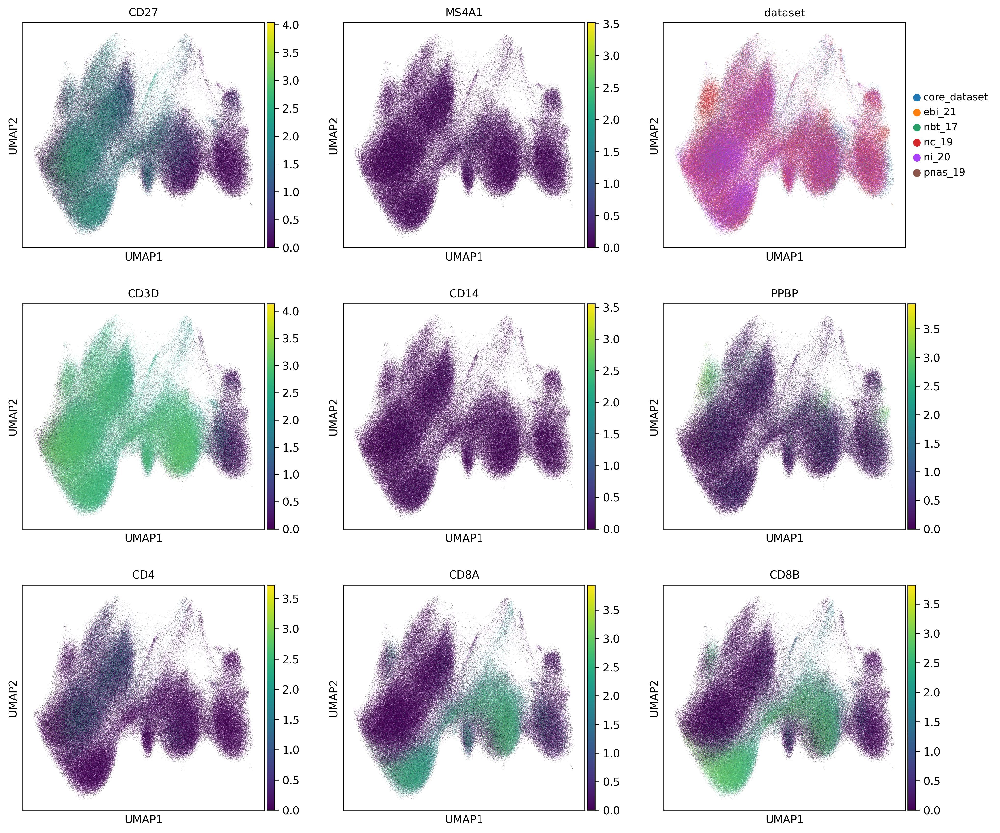

In [9]:
sc.pl.umap(tcell, color=['CD27', 'MS4A1', 'dataset', 'CD3D', 'CD14', 'PPBP',
                         'CD4', 'CD8A', 'CD8B'], ncols=3)

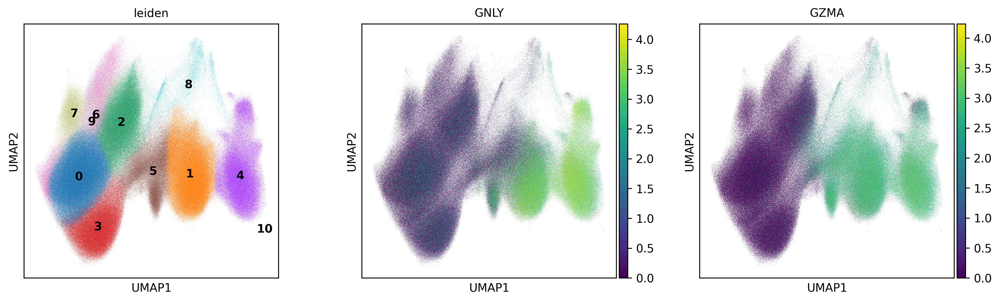

In [11]:
sc.pl.umap(tcell, color=['leiden', 'GNLY', 'GZMA'], ncols=3, legend_loc='on data')

In [19]:
cd4t = tcell[tcell.obs.leiden.isin(['0', '2', '6', '9']), :]
cd8t = tcell[tcell.obs.leiden.isin(['1', '3', '5', '8']), :]

In [28]:
cd4t = cd4t.raw.to_adata()
cd8t = cd8t.raw.to_adata()

In [29]:
cd4t = utils.do_harmony(cd4t, hvg_batch=False, max_iter_harmony=20, theta=2)
cd8t = utils.do_harmony(cd8t, hvg_batch=False, max_iter_harmony=20, theta=2)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/home/xiacr/miniconda3/envs/sle/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:12)


/home/xiacr/miniconda3/envs/sle/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:03:05)
Use GPU mode.
	Initialization is completed.
	Completed 1 / 20 iteration(s).
	Completed 2 / 20 iteration(s).
	Completed 3 / 20 iteration(s).
Reach convergence after 3 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:29)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:20:31)
computing UMAP


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:09:22)
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/home/xiacr/miniconda3/envs/sle/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:03)


/home/xiacr/miniconda3/envs/sle/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:02:04)
Use GPU mode.
	Initialization is completed.
	Completed 1 / 20 iteration(s).
	Completed 2 / 20 iteration(s).
	Completed 3 / 20 iteration(s).
	Completed 4 / 20 iteration(s).
Reach convergence after 4 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:02)
running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:07:21)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:08:51)


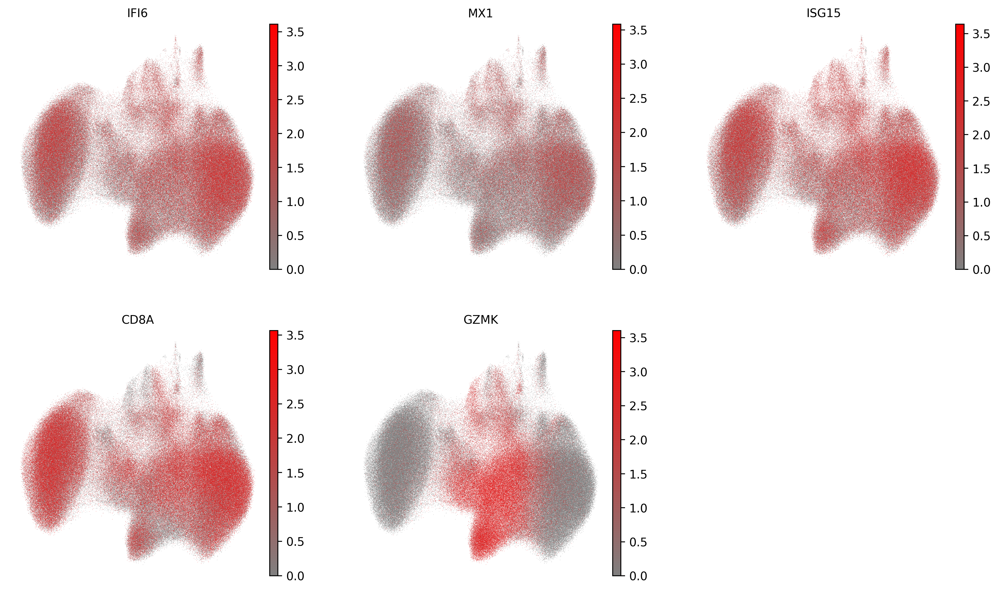

In [53]:
cvals = [0., 0.1]
colors = ["gray", "red"]

norm = plt.Normalize(min(cvals), max(cvals))
tuples = list(zip(map(norm, cvals), colors))
cmap = mpl.colors.LinearSegmentedColormap.from_list("", tuples)
sc.pl.umap(cd8t, color=['IFI6', 'MX1', 'ISG15', 'CD8A', 'GZMK'], ncols=3,
           color_map=cmap, frameon=False)

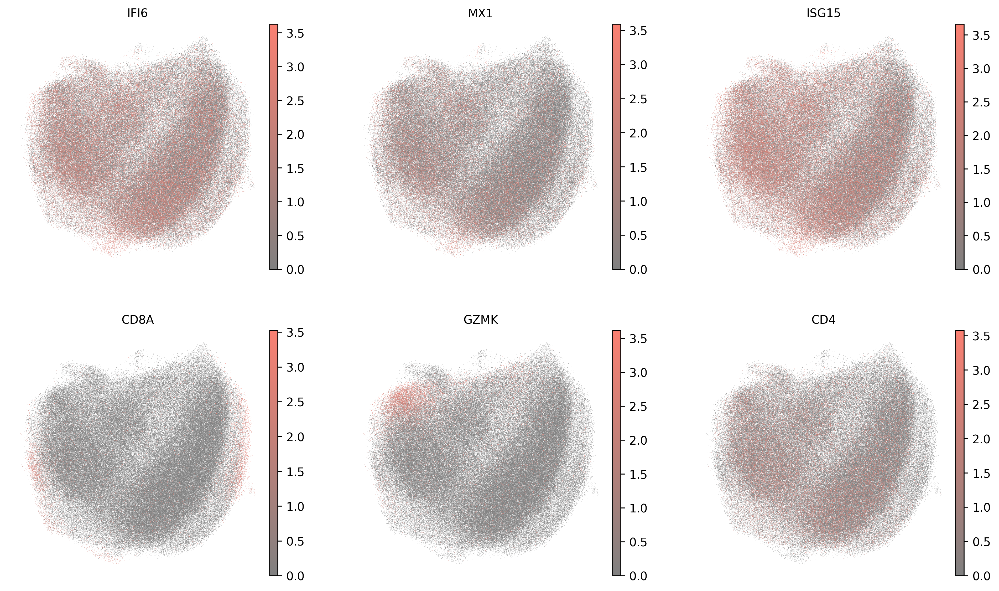

In [36]:
sc.pl.umap(cd4t, color=['IFI6', 'MX1', 'ISG15', 'CD8A', 'GZMK', 'CD4'], ncols=3,
           palette="Set2", color_map=cmap, frameon=False)